In [3]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from tqdm import tqdm

from astropy.io import fits
import fitsio

In [4]:
import lightkurve as lk
from scipy import stats
from astropy.time import Time
import astropy.units as u
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
from astropy.visualization import simple_norm

In [6]:
from roman_lcs import Machine

In [4]:
PATH = "/home/jorgemarpa/teams/lobster/trexs/data"

In [75]:
ff = sorted(os.listdir(f"{PATH}/imgs"))
len(ff)

100

In [76]:
ff

['rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0013_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0025_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0026_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0038_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0039_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0051_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0052_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0105_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0118_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0130_sim.fits',
 'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp

In [77]:
catalog = pd.read_csv(f"{PATH}/mean_input_catalog.txt", index_col=0)
catalog

,sicbroid,xcol,ycol,F146,ra_deg,dec_deg
-1,0,125.000000,125.000000,17.000,268.279268,-28.746497
0,1,175.281640,217.529604,20.717,268.282355,-28.744864
1,2,69.039869,140.004071,24.701,268.277838,-28.745248
2,3,24.095405,52.197116,23.149,268.274992,-28.746840
3,4,151.019019,217.089188,23.617,268.281617,-28.744503
...,...,...,...,...,...,...
18545,18546,49.219505,94.403485,24.868,268.276466,-28.746129
18546,18547,2.039745,110.334565,25.123,268.275317,-28.744991
18547,18548,91.446810,21.156735,24.298,268.276492,-28.748681
18548,18549,194.216412,91.312406,23.769,268.280779,-28.748435


In [78]:
catalog.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18551 entries, -1 to 18549
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   sicbroid  18551 non-null  int64  
 1   xcol      18551 non-null  float64
 2   ycol      18551 non-null  float64
 3   F146      18551 non-null  float64
 4   ra_deg    18551 non-null  float64
 5   dec_deg   18551 non-null  float64
dtypes: float64(5), int64(1)
memory usage: 1014.5 KB


In [79]:
hdu = fits.open(f"{PATH}/imgs/{ff[1]}")
hdu.info()

Filename: /home/jorgemarpa/teams/lobster/trexs/data/imgs/rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0025_sim.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      37   (250, 250)   float64   
  1                1 ImageHDU         7   (250, 250)   float64   


In [80]:
hdu[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                  250                                                  
NAXIS2  =                  250                                                  
EXTEND  =                    T                                                  
WCSAXES =                    2 / Number of coordinate axes                      
CRPIX1  =               2044.0 / Pixel coordinate of reference point            
CRPIX2  =               2044.0 / Pixel coordinate of reference point            
PC1_1   =  2.6408985220755E-05 / Coordinate transformation matrix element       
PC1_2   =   1.488440134677E-05 / Coordinate transformation matrix element       
PC2_1   = -1.5327517861972E-05 / Coordinate transformation matrix element       
PC2_2   =  2.6000461662718E-

In [81]:
hdu[1].header

XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                  250                                                  
NAXIS2  =                  250                                                  
PCOUNT  =                    0 / number of parameters                           
GCOUNT  =                    1 / number of groups                               

In [82]:
ff[0]

'rimtimsim_WFI_rampfitted_F146_SCA01_field01_ramp_subframe_0250x0250_20270214T0013_sim.fits'

In [83]:
WCS(hdu[0].header)

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 268.36960505418  -28.726036480675  
CRPIX : 2044.0  2044.0  
PC1_1 PC1_2  : 2.6408985220755e-05  1.488440134677e-05  
PC2_1 PC2_2  : -1.5327517861972e-05  2.6000461662718e-05  
CDELT : 1.0  1.0  
NAXIS : 250  250

In [84]:
hdu[1].data

array([[0.48938825, 0.55388515, 0.6339903 , ..., 0.86721568, 0.89125013,
        0.60700584],
       [0.46656462, 0.55738273, 0.81261647, ..., 0.98609316, 1.08293188,
        0.77200085],
       [0.53080811, 0.57157386, 0.59585511, ..., 0.92895033, 0.99182815,
        1.05008254],
       ...,
       [0.96679865, 1.3452468 , 1.80719367, ..., 0.60496758, 0.59680045,
        0.51169444],
       [0.86583796, 1.13498704, 1.40227427, ..., 0.52494249, 0.510254  ,
        0.52126645],
       [0.76922923, 0.87117491, 0.95747238, ..., 0.5336056 , 0.49526153,
        0.50978333]], dtype='>f8')

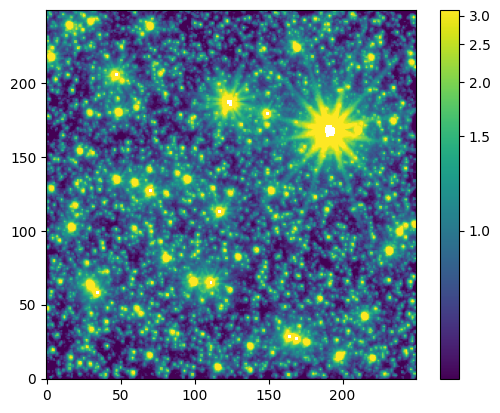

In [85]:
norm = simple_norm(hdu[1].data.ravel(), 'asinh', percent=95)

ima = plt.imshow(hdu[1].data, norm=norm, origin='lower')
plt.colorbar(ima)
plt.show()

In [86]:
hdu[1].data.shape

(250, 250)

In [87]:
imgs = []
img_err = []
times = []
wcss = []
ra, dec = [], []

row, col = np.mgrid[0 : hdu[1].data.shape[0], 0 : hdu[1].data.shape[1]]

for k, f in tqdm(enumerate(ff), total=len(ff)):
    aux = fitsio.FITS(f"{PATH}/imgs/{f}")[0]
    dims = aux.get_dims()

    imgs.append(aux[:, :].T)
    # imgs.append(aux[:, :].T)
    times.append((aux.read_header()["TEND"] + aux.read_header()["TSTART"]) / 2)
    wcss.append(WCS(aux.read_header()))
    radec = wcss[-1].all_pix2world(np.array([col.ravel(), row.ravel()]).T, 0.0).T
    ra.append(radec[0].reshape(dims))
    dec.append(radec[1].reshape(dims))

    # break
imgs = np.array(imgs)
times = np.array(times)
ra = np.array(ra)
dec = np.array(dec)
imgs.shape, times.shape

100%|██████████| 100/100 [00:06<00:00, 16.15it/s]


((100, 250, 250), (100,))

In [88]:
catalog["flux"] = 10 ** ((27.53861667037689 - catalog["F146"])/2.5)
catalog["flux_err"] = np.sqrt(catalog["flux"])
catalog

,sicbroid,xcol,ycol,F146,ra_deg,dec_deg,flux,flux_err
-1,0,125.000000,125.000000,17.000,268.279268,-28.746497,16422.779737,128.151394
0,1,175.281640,217.529604,20.717,268.282355,-28.744864,535.360923,23.137868
1,2,69.039869,140.004071,24.701,268.277838,-28.745248,13.647298,3.694225
2,3,24.095405,52.197116,23.149,268.274992,-28.746840,56.996301,7.549589
3,4,151.019019,217.089188,23.617,268.281617,-28.744503,37.037927,6.085879
...,...,...,...,...,...,...,...,...
18545,18546,49.219505,94.403485,24.868,268.276466,-28.746129,11.701638,3.420766
18546,18547,2.039745,110.334565,25.123,268.275317,-28.744991,9.252235,3.041749
18547,18548,91.446810,21.156735,24.298,268.276492,-28.748681,19.780928,4.447576
18548,18549,194.216412,91.312406,23.769,268.280779,-28.748435,32.199318,5.674444


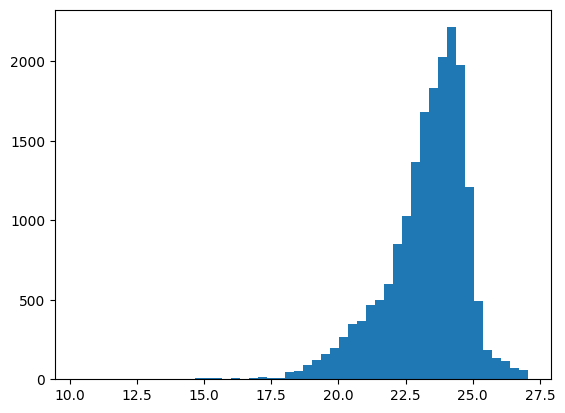

In [89]:
plt.hist(catalog.F146, bins=50)
plt.show()

In [90]:
sources = catalog.query("F146 < 21")
sources["ra"] = sources.ra_deg
sources["dec"] = sources.dec_deg
sources

/tmp/ipykernel_217/3774519869.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sources["ra"] = sources.ra_deg
/tmp/ipykernel_217/3774519869.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sources["dec"] = sources.dec_deg


,sicbroid,xcol,ycol,F146,ra_deg,dec_deg,flux,flux_err,ra,dec
-1,0,125.000000,125.000000,17.000,268.279268,-28.746497,16422.779737,128.151394,268.279268,-28.746497
0,1,175.281640,217.529604,20.717,268.282355,-28.744864,535.360923,23.137868,268.282355,-28.744864
4,5,208.192458,79.438460,19.243,268.280998,-28.748958,2080.878237,45.616644,268.280998,-28.748958
24,25,193.979337,105.265561,20.793,268.281009,-28.748069,499.167922,22.342066,268.281009,-28.748069
31,32,225.556490,69.568893,20.910,268.281353,-28.749481,448.174010,21.170121,268.281353,-28.749481
...,...,...,...,...,...,...,...,...,...,...
18465,18466,155.160154,30.841295,20.751,268.278575,-28.749407,518.855791,22.778406,268.278575,-28.749407
18479,18480,179.040602,73.442134,20.845,268.280018,-28.748666,475.824356,21.813399,268.280018,-28.748666
18481,18482,126.902694,152.644854,15.671,268.279795,-28.745808,55853.020971,236.332437,268.279795,-28.745808
18506,18507,10.192706,91.303237,19.849,268.275238,-28.745611,1190.821503,34.508282,268.275238,-28.745611


In [91]:
imgs.shape

(100, 250, 250)

In [92]:
flux = imgs.reshape(times.shape[0], dims[0] * dims[1])
flux_err = np.sqrt(flux)

row, column = np.mgrid[: dims[0], : dims[1]]
row = row.ravel()
column = column.ravel()

RA = ra.reshape(times.shape[0], dims[0] * dims[1])
DEC = dec.reshape(times.shape[0], dims[0] * dims[1])

row.shape, column.shape, RA.shape, DEC.shape

((62500,), (62500,), (100, 62500), (100, 62500))

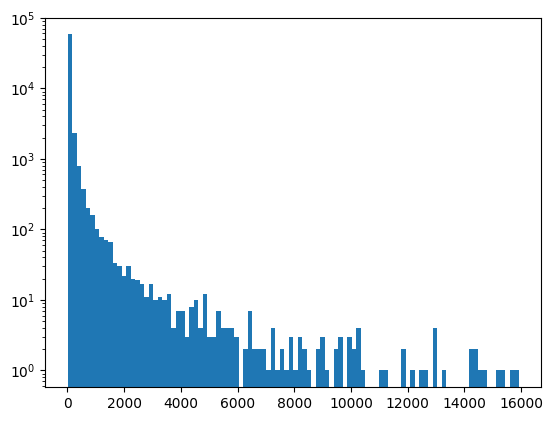

In [93]:
plt.hist(flux[0].ravel(), bins=100, log=True)
plt.show()

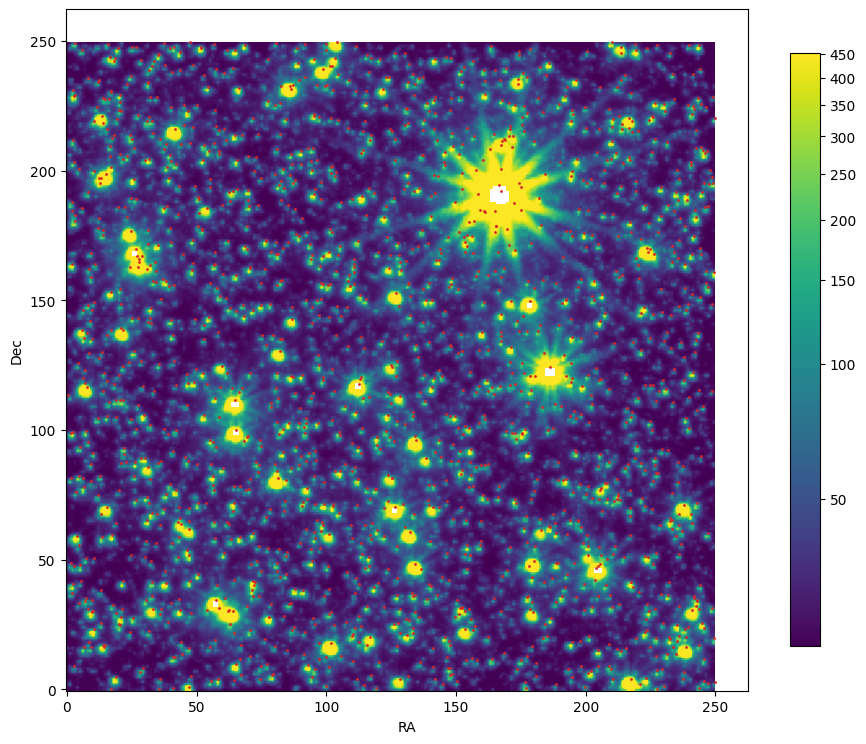

In [94]:
norm = simple_norm(flux[0].ravel(), 'asinh', percent=95)

plt.figure(figsize=(11, 11))
bar = plt.imshow(flux[0].reshape(dims), norm=norm, origin="lower")
plt.colorbar(bar, shrink=.7)
plt.scatter(sources.xcol, sources.ycol, c="tab:red", marker="o", s=1)
plt.xlabel("RA")
plt.ylabel("Dec")
plt.show()

/tmp/ipykernel_217/1486116332.py:3: UserWarning: Adding colorbar to a different Figure <Figure size 1100x1100 with 3 Axes> than <Figure size 1500x1500 with 1 Axes> which fig.colorbar is called on.
  plt.colorbar(bar, shrink=.7)


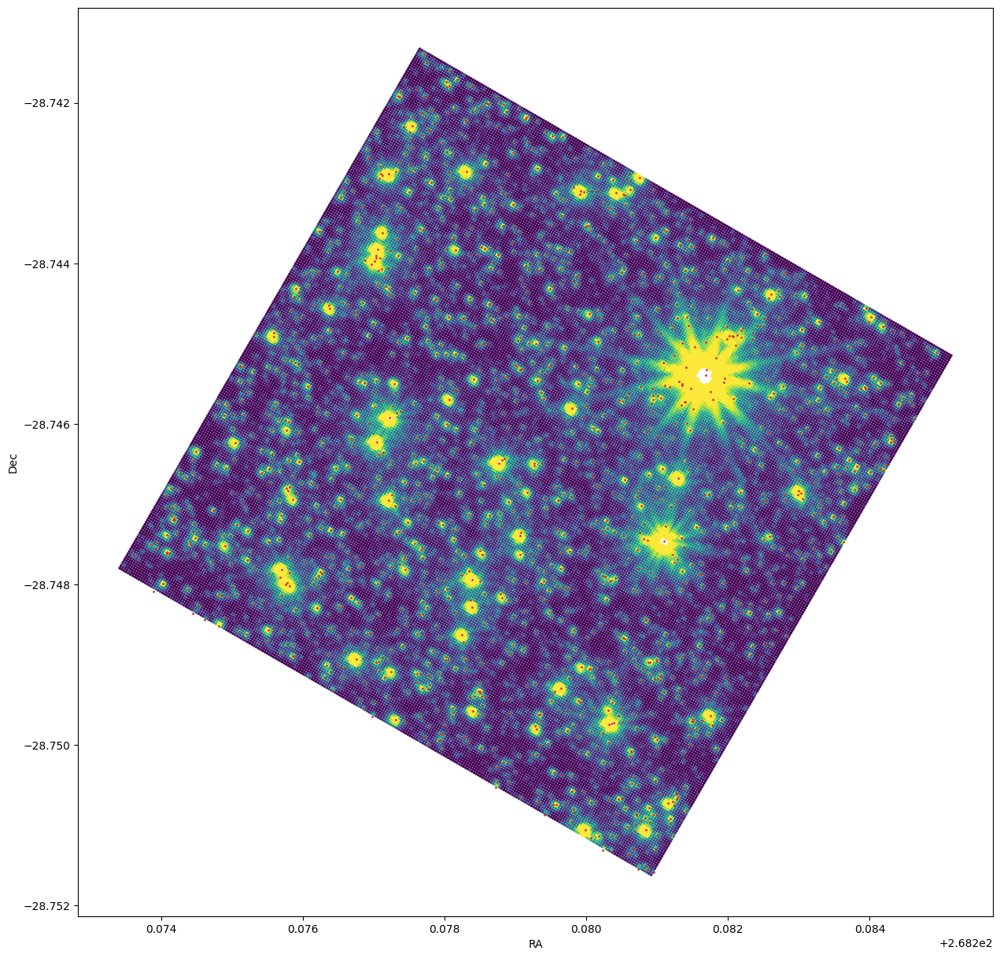

In [95]:
plt.figure(figsize=(15, 15))
plt.scatter(RA[0], DEC[0], c=flux[0], norm=norm, s=3, marker="h")
plt.colorbar(bar, shrink=.7)
plt.scatter(sources.ra_deg, sources.dec_deg, c="tab:red", marker="o", s=1)
plt.xlabel("RA")
plt.ylabel("Dec")
plt.show()

In [96]:
ra_dit = (RA - RA[0]).mean(axis=1)
dec_dit = (DEC - DEC[0]).mean(axis=1)

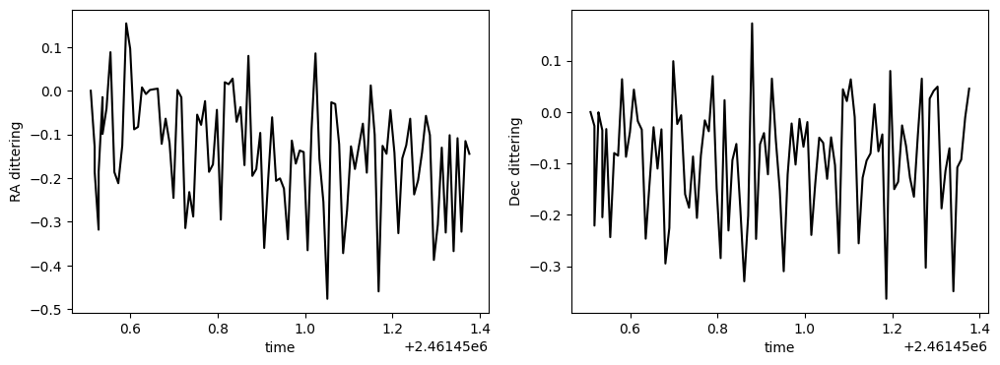

In [100]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4))

ax[0].set_xlabel("time")
ax[0].set_ylabel("RA dittering")
ax[0].plot(times, ra_dit * 3600, "k")
ax[1].set_xlabel("time")
ax[1].set_ylabel("Dec dittering")
ax[1].plot(times, dec_dit * 3600, "k")

plt.show()

# Initialize Machine object

In [33]:
def load_shape_model(self, input=None, plot=False, flux_cut_off=0.01):
    # check if file exists and is the right format
    if not os.path.isfile(input):
        raise FileNotFoundError(f"No shape file: {input}")

    # create source mask and uncontaminated pixel mask
    # if not hasattr(self, "source_mask"):
    self._get_source_mask(
        upper_radius_limit = 1.8,
        lower_radius_limit = 0.01,
        upper_flux_limit = 5e5,
        lower_flux_limit = 100,
        correct_centroid_offset=False,
    )

    # open file
    hdu = fits.open(input)
    # check if shape parameters are for correct mission, quarter, and channel
    if hdu[1].header["mission"] != "Roman-Sim":
        raise ValueError(
            "Wrong shape model: file is for mission Roman-Sim"
        )
    print(hdu[1].header["field"])
    if int(hdu[1].header["field"]) != 1:
        raise ValueError("Wrong field")
    if int(hdu[1].header["SCA"]) != 7:
        raise ValueError("Wrong SCA")
        
    # load model hyperparameters and weights
    self.n_r_knots = hdu[1].header["n_rknots"]
    self.n_phi_knots = hdu[1].header["n_pknots"]
    self.rmin = hdu[1].header["rmin"]
    self.rmax = hdu[1].header["rmax"]
    self.cut_r = hdu[1].header["cut_r"]
    self.psf_w = hdu[1].data["psf_w"]
    # read from header if weights come from a normalized model.
    self.normalized_shape_model = (
        True if hdu[1].header.get("norm") in ["True", "T", 1] else False
    )
    del hdu

    # create mean model, but PRF shapes from FFI are in pixels! and TPFMachine
    # work in arcseconds
    self._get_mean_model()
    # remove background pixels and recreate mean model
    self._update_source_mask_remove_bkg_pixels(flux_cut_off=flux_cut_off)

    if plot:
        return self.plot_shape_model()
    return

def save_shape_model(self, output=None):
    # asign a file name
    if output is None:
        output = f"./roman_shape_model_SCA07_field01.fits"

    # create data structure (DataFrame) to save the model params
    table = fits.BinTableHDU.from_columns(
        [fits.Column(name="psf_w", array=self.psf_w, format="D")]
    )
    # include metadata and descriptions
    table.header["object"] = ("PRF shape", "PRF shape parameters")
    table.header["datatype"] = ("FFI cutout", "Type of data used to fit shape model")
    table.header["origin"] = ("PSFmachine.TPFMachine", "Software of origin")
    table.header["version"] = (pm.__version__, "Software version")
    table.header["mission"] = ("Roman-Sim", "Mission name")
    table.header["field"] = ("1", "Field number")
    table.header["SCA"] = (7, "Sensor Chip Assembly",
    )
    table.header["n_rknots"] = (
        self.n_r_knots,
        "Number of knots for spline basis in radial axis",
    )
    table.header["n_pknots"] = (
        self.n_phi_knots,
        "Number of knots for spline basis in angle axis",
    )
    table.header["rmin"] = (self.rmin, "Minimum value for knot spacing")
    table.header["rmax"] = (self.rmax, "Maximum value for knot spacing")
    table.header["cut_r"] = (
        self.cut_r,
        "Radial distance to remove angle dependency",
    )
    # spline degree is hardcoded in `_make_A_polar` implementation.
    table.header["spln_deg"] = (3, "Degree of the spline basis")
    table.header["norm"] = (
        int(self.normalized_shape_model),
        "Normalized weights",
    )

    table.writeto(output, checksum=True, overwrite=True)

    return

In [34]:
nan_mask = np.isfinite(flux).all(axis=0)
nan_mask.shape

(62500,)

In [35]:
flux[:, nan_mask].shape

(100, 62152)

In [36]:
RA.shape

(100, 62500)

In [37]:
RA.std(axis=0) * 3600

array([0.12551219, 0.12551219, 0.12551219, ..., 0.12551265, 0.12551265,
       0.12551265])

In [38]:
idx = [0]

mac = pm.Machine(
    times[idx], 
    flux[[idx], nan_mask], 
    flux_err[[idx], nan_mask], 
    RA[[idx], nan_mask], 
    DEC[[idx], nan_mask], 
    sources, 
    column[nan_mask], 
    row[nan_mask], 
    sparse_dist_lim=2, 
    sources_flux_column="flux", 
)
## use < 21 only for contamination
mac.contaminant_flux_limit = 10 ** ((27.648 - 21)/2.5)
mac

Creating delta arrays: 100%|██████████| 1698/1698 [00:03<00:00, 505.24it/s]


Machine (N sources, N times, N pixels): (1698, 1, 62152)

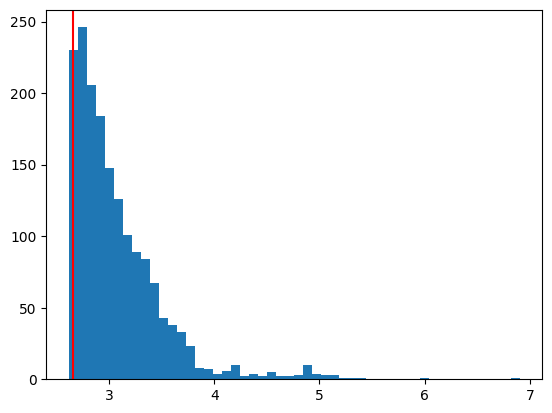

In [39]:
plt.hist(np.log10(mac.source_flux_estimates), bins=50)
plt.axvline(np.log10(mac.contaminant_flux_limit), c="r")
plt.show()

In [40]:
mac.ra.shape

(1, 62152)

In [41]:
mac.ra.shape, mac.dec.shape

((1, 62152), (1, 62152))

In [42]:
mac.flux[0].shape

(62152,)

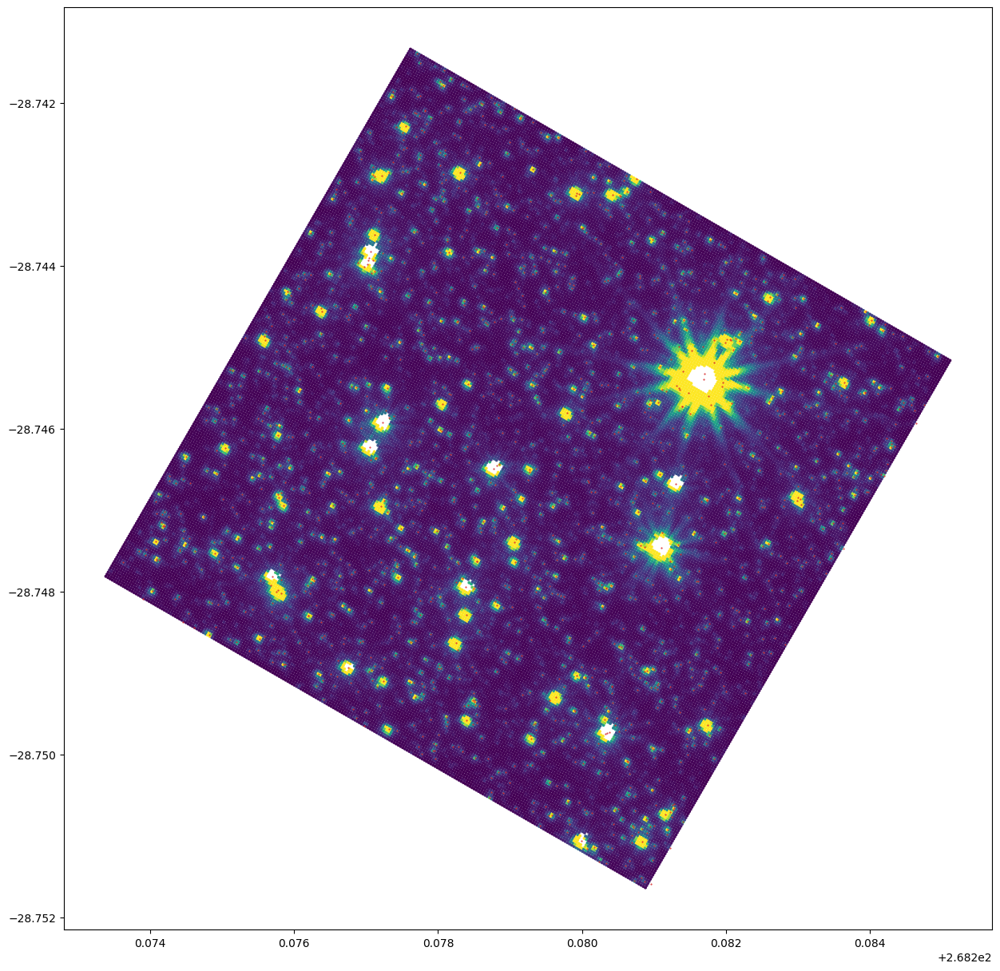

In [43]:
plt.figure(figsize=(15,15))
plt.scatter(mac.ra, mac.dec, c=mac.flux[0], s=4, marker="h", vmin=10, vmax=500)
plt.scatter(mac.sources.ra, mac.sources.dec, s=1, marker=".", c="tab:red")
plt.show()

In [44]:
mac.sources = mac.sources.reset_index(drop=False)

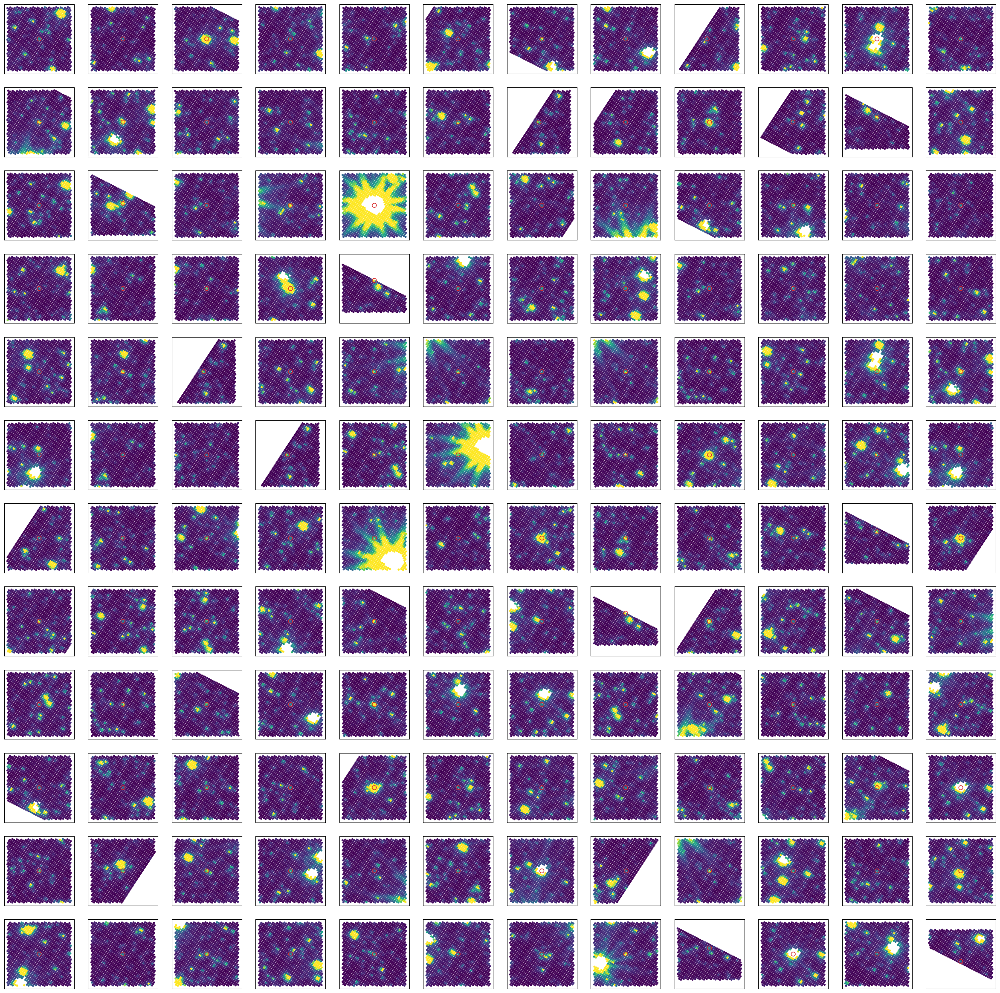

In [45]:
flux_masked = mac.r.astype(bool).multiply(mac.flux[0]).tocsr()
# flux_masked

fig, ax = plt.subplots(12, 12, figsize=(30,30))
for i, k in enumerate(np.random.choice(mac.sources.query("F146 < 20").index.values, size=12*12)):
    ax.ravel()[i].scatter(mac.dra[k].data*3600, mac.ddec[k].data*3600, s=7, marker="o", c=flux_masked[k].data, vmin=10, vmax=500)
    ax.ravel()[i].scatter(0, 0, s=50, edgecolor="tab:red", marker="o", facecolor="none", lw=1)
    ax.ravel()[i].axis('equal')
    ax.ravel()[i].set_xticks([])
    ax.ravel()[i].set_yticks([])
plt.show()

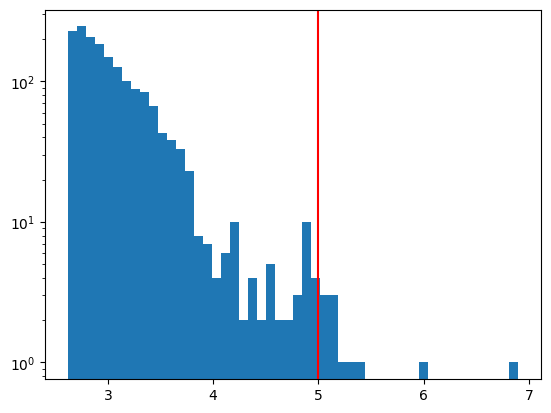

In [46]:
plt.hist(np.log10(mac.source_flux_estimates), bins=50, log=True)
plt.axvline(np.log10(1e5), c="r")
plt.show()

In [47]:
from psfmachine.utils import sparse_lessthan

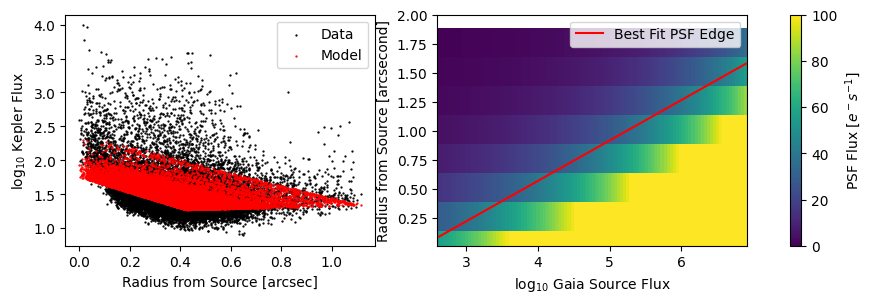

In [48]:
# god params for Roman
upper_radius_limit = 2.
lower_radius_limit = 0.01
upper_flux_limit = 1e5
lower_flux_limit = 50

mac._get_source_mask(
    upper_radius_limit=upper_radius_limit,
    lower_radius_limit=lower_radius_limit,
    upper_flux_limit=upper_flux_limit,
    lower_flux_limit=lower_flux_limit,
    correct_centroid_offset=False,
    plot=True,
);

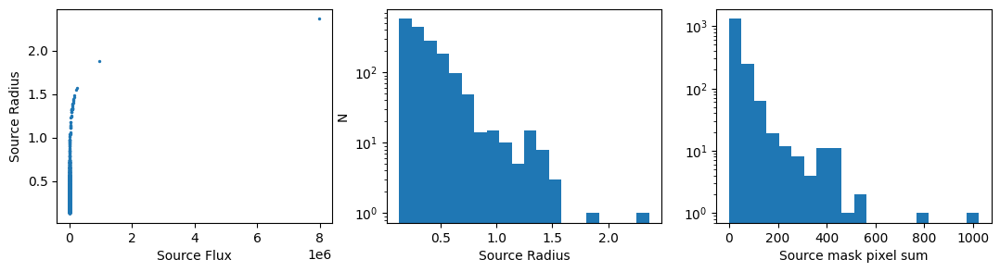

In [49]:
fig, ax = plt.subplots(1, 3, figsize=(13, 3))

ax[0].scatter(mac.sources.flux, mac.radius, s=2)
ax[0].set_xlabel("Source Flux")
ax[0].set_ylabel("Source Radius")

ax[1].hist(mac.radius, bins=20)
ax[1].set_xlabel("Source Radius")
ax[1].set_ylabel("N")
ax[1].set_yscale("log")

ax[2].hist(np.array(mac.source_mask.sum(axis=1)).ravel(), bins=20)
ax[2].set_xlabel("Source mask pixel sum")
ax[2].set_yscale("log")

plt.show()

In [50]:
mac.source_mask, mac.uncontaminated_source_mask

(<1698x62152 sparse matrix of type '<class 'numpy.bool_'>'
 	with 72676 stored elements in Compressed Sparse Row format>,
 <1698x62152 sparse matrix of type '<class 'numpy.bool_'>'
 	with 22528 stored elements in Compressed Sparse Row format>)

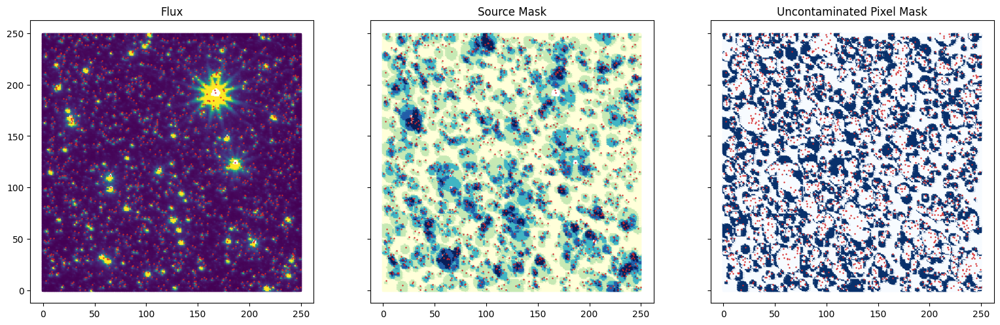

In [51]:
fig, ax = plt.subplots(1, 3, figsize=(19, 7), sharex=True, sharey=True)

ax[0].set_title("Flux")
ax[0].scatter(
    mac.column,
    mac.row,
    c=mac.flux[0], 
    vmin=10, 
    vmax=500,
    s=5,
    marker="s",
)
ax[0].scatter(mac.sources.xcol, mac.sources.ycol, c="tab:red", marker=".", s=2)

ax[1].set_title("Source Mask")
ax[1].scatter(
    mac.column,
    mac.row,
    c=np.array(mac.source_mask.sum(axis=0)[0]), 
    vmin=0, 
    vmax=4,
    alpha=1,
    cmap="YlGnBu",
    s=5,
    marker="s",
)
ax[1].scatter(mac.sources.xcol, mac.sources.ycol, c="tab:red", marker=".", s=2)

ax[2].set_title("Uncontaminated Pixel Mask")
ax[2].scatter(
    mac.column,
    mac.row,
    c=np.array(mac.uncontaminated_source_mask.sum(axis=0)[0]), 
    vmin=0, 
    vmax=1,
    alpha=1,
    cmap="Blues",
    s=5,
    marker="s",
)
ax[2].scatter(mac.sources.xcol, mac.sources.ycol, c="tab:red", marker=".", s=2)
# ax[0].set_xlim(-5, cutout_size + 5)
# ax[0].set_ylim(-5, cutout_size + 5)

ax[0].set_aspect("equal", adjustable="box")
ax[1].set_aspect("equal", adjustable="box")
ax[2].set_aspect("equal", adjustable="box")

plt.show()

/home/jorgemarpa/envs/conda/roman-psfmachine/lib/python3.9/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


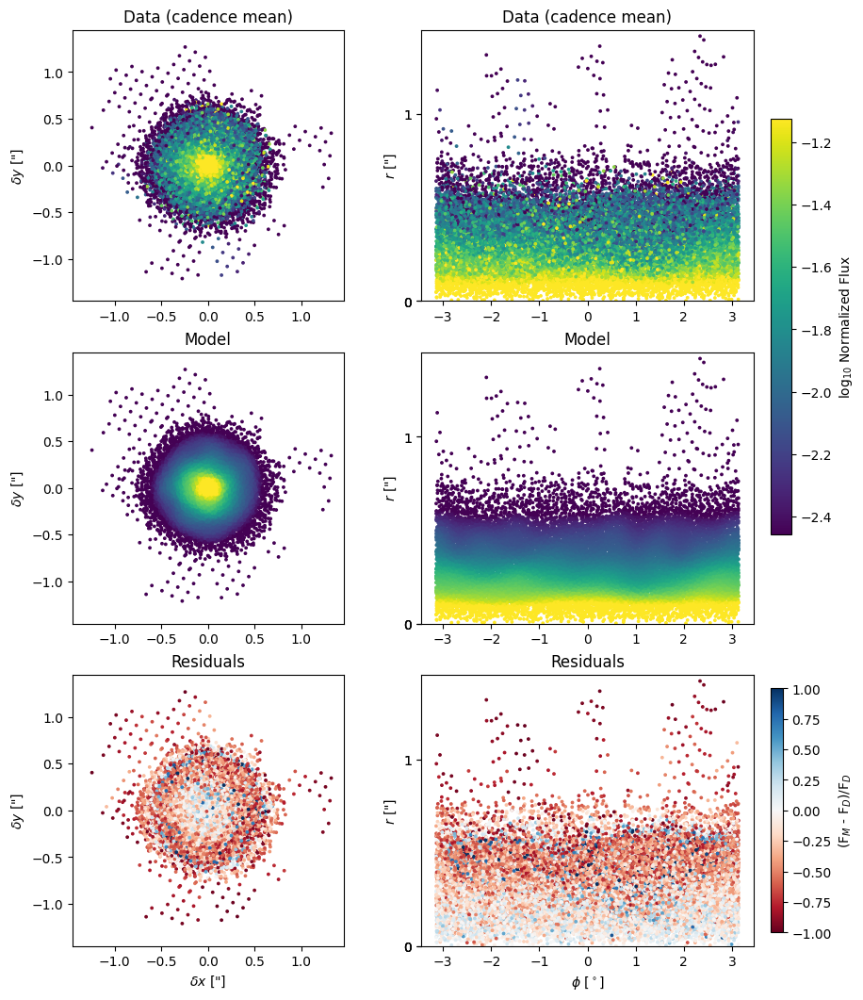

In [52]:
mac.rmin = 0.02
mac.rmax = 0.8
mac.cut_r = 0.15
mac.n_r_knots = 9
mac.n_phi_knots = 15

mac.build_shape_model(
    plot=True,
    flux_cut_off=0.05,
    frame_index='mean',
    bin_data=False,
    upper_radius_limit=upper_radius_limit,
    lower_radius_limit=lower_radius_limit,
    upper_flux_limit=upper_flux_limit,
    lower_flux_limit=lower_flux_limit,
    correct_centroid_offset=False,
)
plt.show()

In [208]:
mac.mean_model_integral

0.2170284351982929

In [209]:
outf = f"roman_WFI_{hdu[0].header['READMODE']}_{hdu[0].header['FILTER']}_{hdu[0].header['DETECTOR']}_shape_model_cad{idx[0]}.fits"
print(outf)

# save_shape_model(mac, output=outf)

roman_WFI_ramp_F146_SCA01_shape_model_cad0.fits


In [210]:
mac.source_mask, mac.uncontaminated_source_mask

(<1698x62152 sparse matrix of type '<class 'numpy.bool_'>'
 	with 168311 stored elements in Compressed Sparse Row format>,
 <1698x62152 sparse matrix of type '<class 'numpy.bool_'>'
 	with 11824 stored elements in Compressed Sparse Row format>)

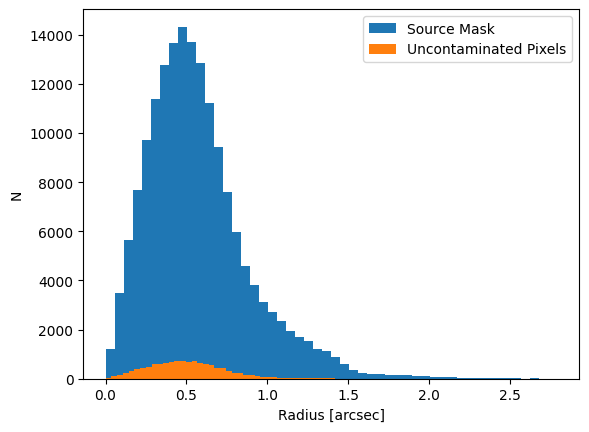

In [211]:
plt.hist(mac.source_mask.multiply(mac.r).data, bins=50, label="Source Mask")
plt.hist(mac.uncontaminated_source_mask.multiply(mac.r).data, bins=50, label="Uncontaminated Pixels")
plt.legend(loc="upper right")
plt.xlabel("Radius [arcsec]")
plt.ylabel("N")
plt.show()

In [212]:
mac.time_radius, mac.time_nknots, mac.time_resolution

(8, 10, 200)

In [213]:
mac.fit_model(fit_va=False)

Fitting 1698 Sources (w. VA): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]


In [214]:
(mac.ws.mean(axis=0) < 0).sum()

85

In [215]:
mac.get_psf_metrics(npoints_per_pixel=0)

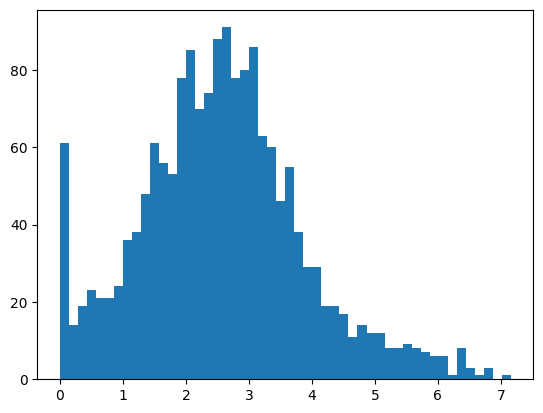

In [216]:
plt.hist(mac.source_psf_fraction, bins=50)
plt.show()

In [217]:
np.array(mac.mean_model.sum(axis=1)).ravel()

array([5.63368   , 2.24530663, 4.05919273, ..., 6.63833919, 2.93219539,
       1.62964135])

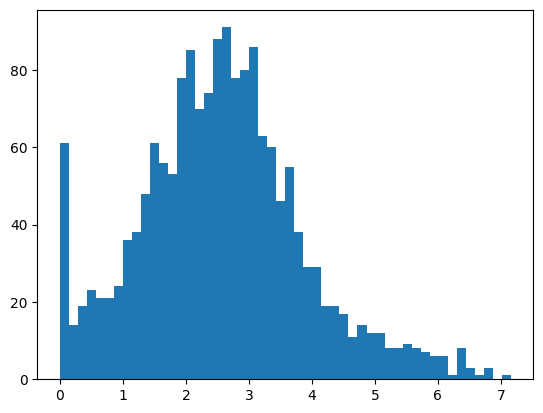

In [218]:
plt.hist(np.array(mac.mean_model.sum(axis=1)).ravel(), bins=50);

In [219]:
mac.model_flux

array([[ 0.        ,  0.        ,  0.        , ..., 16.50220296,
        15.68349854, 12.91194536]])

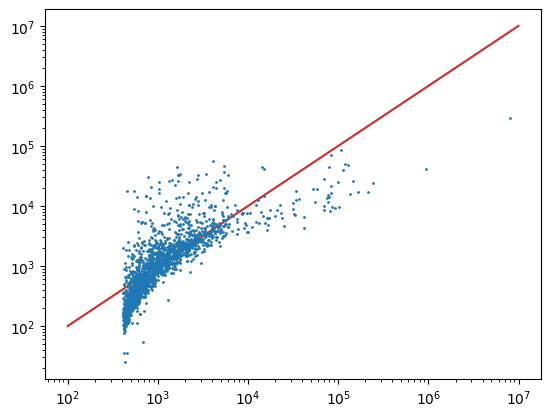

In [220]:
plt.plot([1e2, 1e7], [1e2, 1e7], c="tab:red", zorder=-1000)
plt.scatter(mac.sources.flux.values, mac.sap_flux, s=1)
plt.xscale("log")
plt.yscale("log")
plt.show()

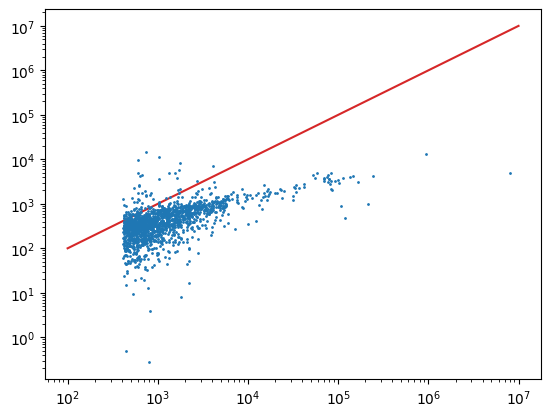

In [223]:
plt.plot([1e2, 1e7], [1e2, 1e7], c="tab:red", zorder=-1000)
plt.scatter(mac.sources.flux.values, mac.ws.mean(axis=0), s=1)
plt.xscale("log")
plt.yscale("log")
plt.show()

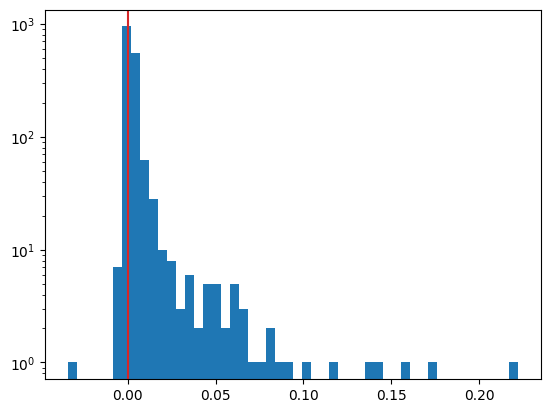

In [186]:
plt.hist(mac.ws.mean(axis=0) / mac.sources.flux.values, bins=50, log=True)
plt.axvline(0, c="tab:red")
plt.show()

## LC precision

In [165]:
lcs_psf = lk.LightCurveCollection([lk.LightCurve(time=mac.time * u.d, flux=mac.ws[:, k], flux_err=mac.werrs[:, k], meta={"ID": mac.sources.index[k]}) for k in range(mac.nsources)])
lcs_sap = lk.LightCurveCollection([lk.LightCurve(time=mac.time * u.d, flux=mac.sap_flux[:, k], flux_err=mac.sap_flux_err[:, k], meta={"ID": mac.sources.index[k]}) for k in range(mac.nsources)])

In [166]:
lcs_psf[10].estimate_cdpp()

<Quantity 2605.54291355 ppm>

In [167]:
cdpp_psf = np.array([lc.estimate_cdpp().value for lc in lcs_psf])
cdpp_sap = np.array([lc.estimate_cdpp().value for lc in lcs_sap])

ppp_psf = (1.48 / np.sqrt(2)) * stats.median_abs_deviation(mac.ws[1:] - mac.ws[:-1], axis=0)
ppp_sap = (1.48 / np.sqrt(2)) * stats.median_abs_deviation(mac.sap_flux[1:] - mac.sap_flux[:-1], axis=0)

/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:1127: LightkurveWarning: The light curve appears to be zero-centered (median=9.66e-01 +/- 1.68e+01); `normalize()` will divide the light curve by a value close to zero, which is probably not what you want.
  warnings.warn(
/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:1127: LightkurveWarning: The light curve appears to be zero-centered (median=9.91e-01 +/- 1.64e+01); `normalize()` will divide the light curve by a value close to zero, which is probably not what you want.
  warnings.warn(
/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/site-packages/lightkurve/lightcurve.py:1127: LightkurveWarning: The light curve appears to be zero-centered (median=1.02e+00 +/- 6.20e+00); `normalize()` will divide the light curve by a value close to zero, which is probably not what you want.
  warnings.warn(
/Users/jorgemarpa/.pyenv/versions/adap/lib/python3.8/si

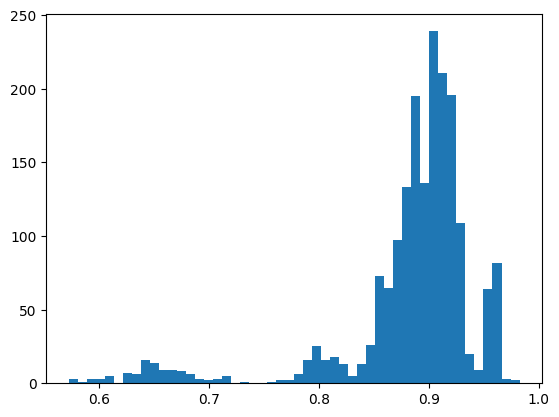

In [168]:
plt.hist(mac.FLFRCSAP, bins=50);

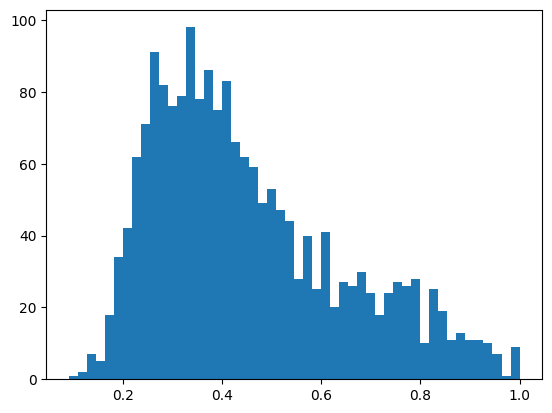

In [169]:
plt.hist(mac.CROWDSAP, bins=50);

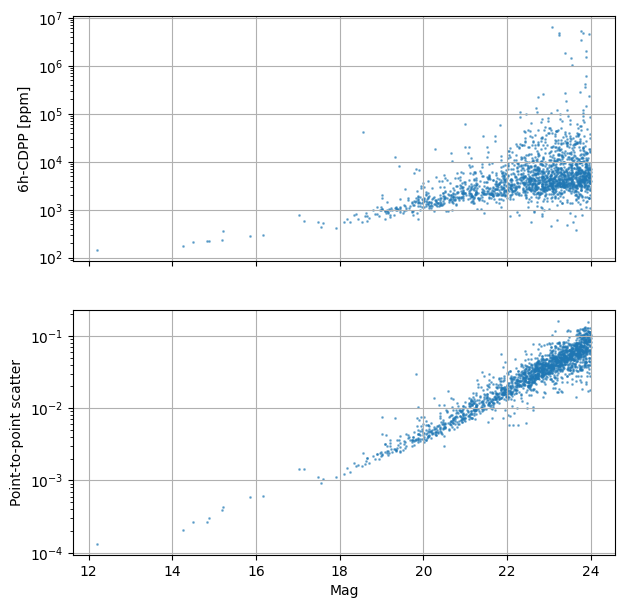

In [170]:
fig, ax = plt.subplots(2,1, figsize=(7,7), sharex=True)

ax[0].scatter(mac.sources.mag, cdpp_psf, s=1, alpha=0.5)
ax[0].set_yscale("log")
ax[0].set_ylabel("6h-CDPP [ppm]")
# ax[0].set_ylim(-1, 40)
ax[0].grid(True)

bar = ax[1].scatter(mac.sources.mag, (ppp_psf/mac.sources.flux), s=1, alpha=0.5)
# fig.colorbar(bar, ax=ax, orientation="vertical", label="CROWD")
ax[1].set_yscale("log")
ax[1].set_xlabel("Mag")
ax[1].set_ylabel("Point-to-point scatter")
# ax[1].set_ylim(-0.001, 0.0201)
ax[1].grid(True)

plt.show()

In [171]:
times

array([2461301.50031667, 2461301.51073333, 2461301.52115   , ...,
       2461373.4690669 , 2461373.47948356, 2461373.48990023])

In [172]:
mac.time

array([2461301.50031667, 2461301.51073333, 2461301.52115   , ...,
       2461373.4690669 , 2461373.47948356, 2461373.48990023])

In [173]:
lcs_psf[k].plot(marker=".", lw=0)

IndexError: list index out of range

In [174]:
bls_stats = pd.DataFrame(index=mac.sources.index, columns=["period", "t0", "duration", "depth", "snr"])

for k in tqdm(range(mac.nsources), total=mac.nsources):
    per = lcs_psf[k].to_periodogram(method="bls", 
                          minimum_period=0.3,
                          maximum_period=50,
                          frequency_factor=30,
                          duration=np.linspace(0.01, 0.2999, 5),
                         )
    bls_stats.loc[mac.sources.index[k], "period"] = per.period_at_max_power.value
    bls_stats.loc[mac.sources.index[k], "t0"] = per.transit_time_at_max_power.value
    bls_stats.loc[mac.sources.index[k], "duration"] = per.duration_at_max_power.value
    bls_stats.loc[mac.sources.index[k], "depth"] = per.depth_at_max_power.value
    bls_stats.loc[mac.sources.index[k], "snr"] = per.snr[np.argmax(per.power)].value

100%|██████████████████████████████████████████████████████████████████████████| 1881/1881 [18:42:48<00:00, 35.82s/it]


In [175]:
bls_stats

,period,t0,duration,depth,snr
687,0.300151,2461301.655317,0.3,58.307564,0.45944
1789,0.300036,2461301.652317,0.3,12.628648,0.175154
2268,0.300182,2461301.655317,0.3,6.234929,0.24579
5449,0.300209,2461301.652317,0.3,6.628602,0.291571
6227,0.30012,2461301.657317,0.3,5.915819,0.393358
...,...,...,...,...,...
4960588,0.300078,2461301.659317,0.3,16.753788,0.236658
4963172,0.300063,2461301.658317,0.3,64.024368,0.626669
4963327,0.300104,2461301.652317,0.3,57.222929,0.476646
4964060,0.301019,2461301.659317,0.3,4.392529,0.514953


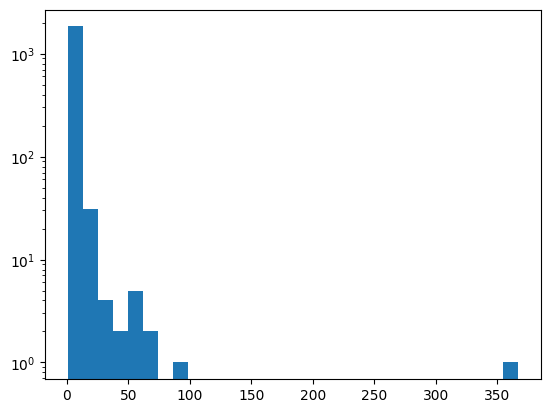

In [176]:
plt.hist(bls_stats.depth.values, bins=30, log=True)
plt.show()

In [177]:
p93, p3 = np.percentile(mac.ws, [93, 3], axis=0)
amp = p93 - p3
SNR = amp / np.median(mac.werrs, axis=0)

In [178]:
depth = (np.nanmean(mac.ws, axis=0) - mac.ws.min(axis=0)) / np.nanmean(mac.ws, axis=0)

In [179]:
depth.shape

(1881,)

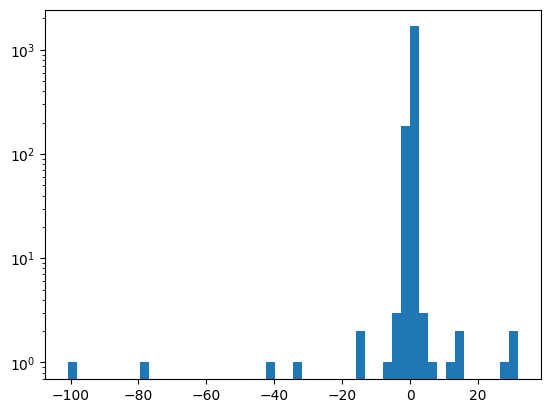

In [180]:
plt.hist(depth, bins=50, log=True)
plt.show()

In [181]:
amp

array([124.01434434,  27.54753646,  17.05574803, ..., 127.28570199,
        19.92311552, 158.75256987])

In [182]:
to_plot = np.where((depth > 0.01) & (depth < 0.03))[0]

In [183]:
to_plot

array([   2,    7,    8,   14,   27,   30,   34,   38,   40,   41,   44,
         47,   53,   54,   57,   66,   72,   74,   75,   77,   84,   85,
         87,   94,  100,  118,  123,  125,  137,  141,  142,  147,  155,
        159,  165,  166,  169,  175,  180,  183,  210,  211,  218,  232,
        233,  235,  239,  245,  249,  259,  263,  279,  284,  287,  288,
        289,  297,  299,  303,  311,  313,  328,  329,  340,  341,  384,
        404,  496,  543,  550,  562,  572,  579,  633,  638,  662,  664,
        678,  692,  697,  732,  852,  887,  888,  902,  973,  978,  981,
        995,  998, 1052, 1102, 1122, 1149, 1167, 1171, 1181, 1199, 1201,
       1207, 1251, 1260, 1271, 1278, 1421, 1428, 1455, 1480, 1495, 1500,
       1516, 1537, 1550, 1551, 1563, 1570, 1578, 1583, 1598, 1607, 1610,
       1634, 1635, 1636, 1644, 1655, 1659, 1662, 1664, 1669, 1671, 1683,
       1688, 1693, 1694, 1695, 1696, 1697, 1699, 1704, 1713, 1714, 1717,
       1721, 1724, 1725, 1727, 1728, 1729, 1731, 17

In [184]:
mac.sources

,xcol,ycol,mag,xcol_,ycol_,flux,flux_err,ra,dec
687,28.46,65.51,14.826,28.125,65.375,134524.070515,366.775232,285.348682,-24.886537
1789,35.09,24.10,18.647,34.875,23.875,3984.740097,63.124798,285.349936,-24.887096
2268,19.34,78.21,19.787,19.125,77.875,1394.440539,37.342209,285.348170,-24.886536
5449,25.17,99.91,20.955,24.875,99.625,475.554176,21.807205,285.347688,-24.886009
6227,22.27,42.11,21.945,22.125,41.875,191.073298,13.822927,285.349188,-24.887089
...,...,...,...,...,...,...,...,...,...
4960588,81.72,53.86,17.550,81.375,53.625,10944.602678,104.616455,285.350061,-24.885458
4963172,39.99,18.72,15.866,39.625,18.375,51617.860550,227.195644,285.350180,-24.887085
4963327,2.12,1.92,15.174,1.875,1.625,97633.756658,312.464009,285.349874,-24.888285
4964060,62.17,37.26,18.948,61.875,37.125,3019.951720,54.954087,285.350119,-24.886216


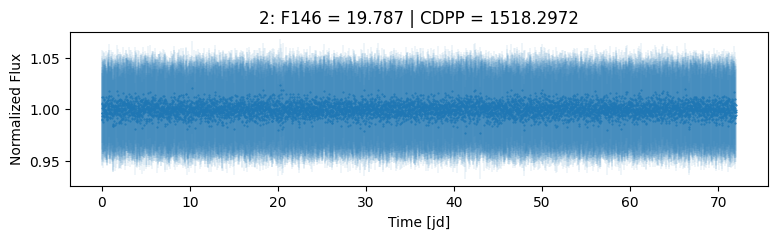

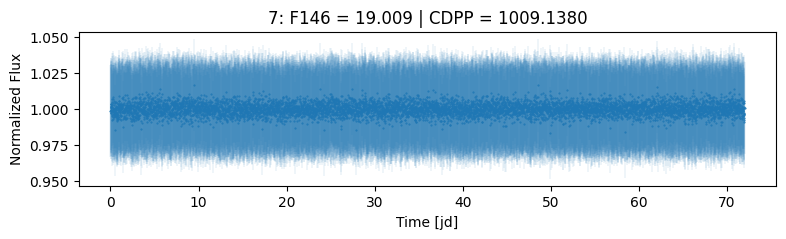

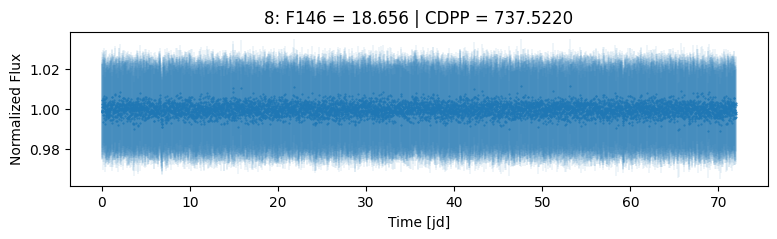

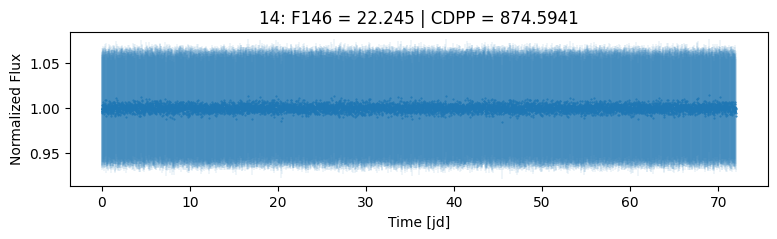

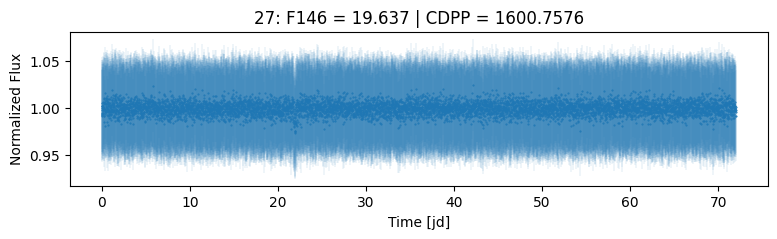

...

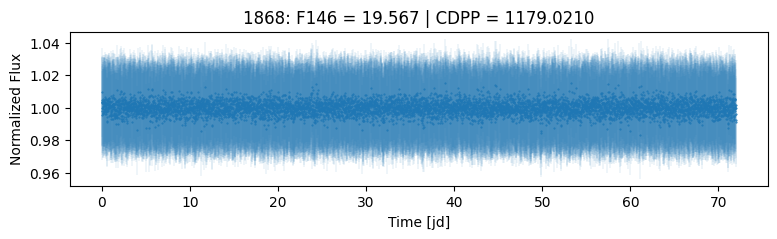

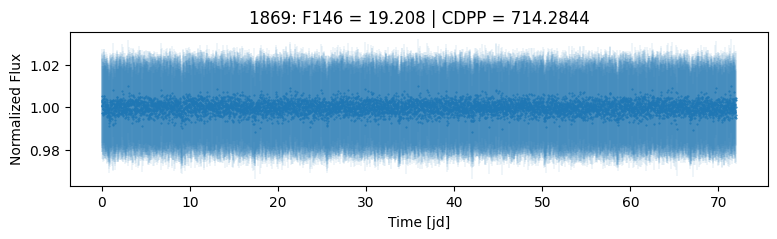

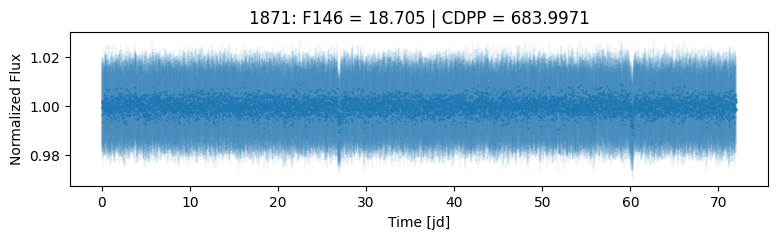

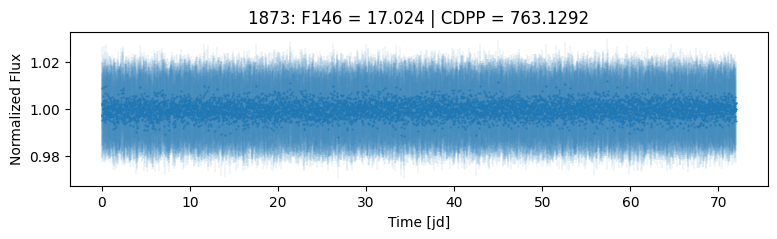

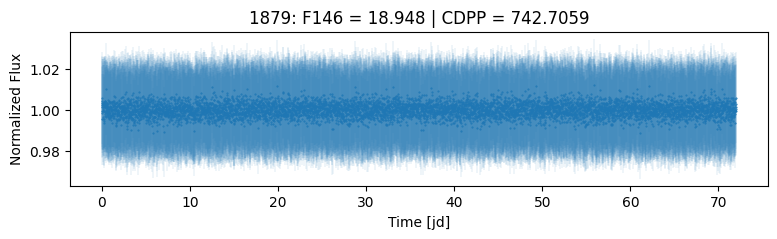

In [185]:
for k in to_plot:
    plt.figure(figsize=(9,2))
    # plt.plot(mac.time - mac.time.min(), mac.ws[:, k]/np.nanmean(mac.ws[:, k]), marker=".", lw=0, ms=1)
    plt.errorbar(mac.time - mac.time.min(), mac.ws[:, k]/np.nanmean(mac.ws[:, k]), yerr=mac.werrs[:, k]/np.nanmean(mac.ws[:, k]), elinewidth=0.1, fmt=".", markersize=1)
    plt.title(f"{k}: F146 = {mac.sources.iloc[k]['mag']} | CDPP = {cdpp_psf[k]:.4f}")
    plt.xlabel("Time [jd]")
    plt.ylabel("Normalized Flux")
    plt.show()
    # break